# Rhode Island Health Providers who speak Spanish
This Jupyter notebook has the packages and codes for scraping the website Nuestra Salud directoria médico: https://www.nuestrasalud.com/directorio-medico. 

These first two code cells install and import the necessary packages to scrape Nuestra Salud and clean the data package. 

In [ ]:
!pip install geopandas

In [2]:
import requests
from bs4 import BeautifulSoup
import re
import numpy as np
import pandas as pd

#programs below are for making pretty graphs
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib as mpl
import geopandas as gpd

plt.style.use('seaborn-v0_8-whitegrid') #styling of the graphs

import plotly.express as px #programs needed for graphing

# https://plotly.com/python/mapbox-county-choropleth/
from urllib.request import urlopen
import json
import plotly.graph_objects as go

## Web scraping Nuestra Salud

The package we're using to scrape data is BeautifulSoup, the documentation to use this program is here https://beautiful-soup-4.readthedocs.io/en/latest/. 

If we need to scrape something more dynamic (sites like Zillow are examples of dynamic websites because scrolling and clicking dynamically fill out the web page), you can use selenium which would need more work. I think this is the documentation, but I'm not as familiar with this: https://selenium-python.readthedocs.io/. 

* First we record the url from Nuestra Salud's directorio médico as `URL`.
* We get the url and assign it to `page`
* Use BeautifulSoup that can look at the html of the webpage and make it understandable to python and save it as `soup`.

In [3]:
#Grabbing Directorio Nuestra Salud

URL = "https://www.nuestrasalud.com/directorio-medico"
page = requests.get(URL)

soup = BeautifulSoup(page.content, "html.parser")

Now using `soup` we'll go through it and grab all the entries from the directoria. Currently the code below should grab everything and generate a list of the data that contains the location, telephone number, the doctor, their expertise, and their degrees, and what is their specialty. 

If this ever stops working then you need to go to the website, right click and inspect the html. Then your website will split on the screen and show all the html. If you hover over a particular line of code, you'll see it highlight a part of the webpage. This is the html code for that part of the website. Since we want the entries to the directoria, we should click on the html tags until we find the innermost code that highlights all of the directoria and if you go one more level in, it would grab specific parts of the directoria. Example 1 shows what works currently, and Example 2 is one layer too deep.

#### Example 1
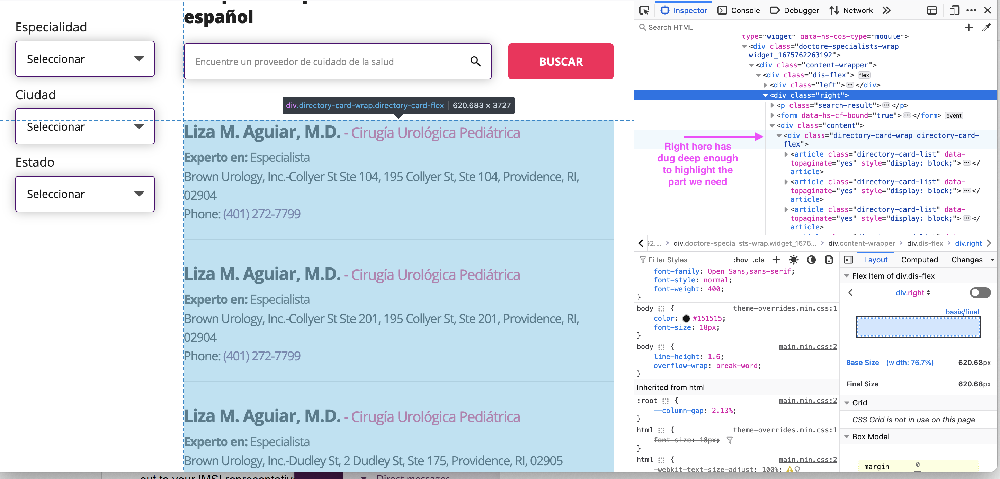

#### Example 2
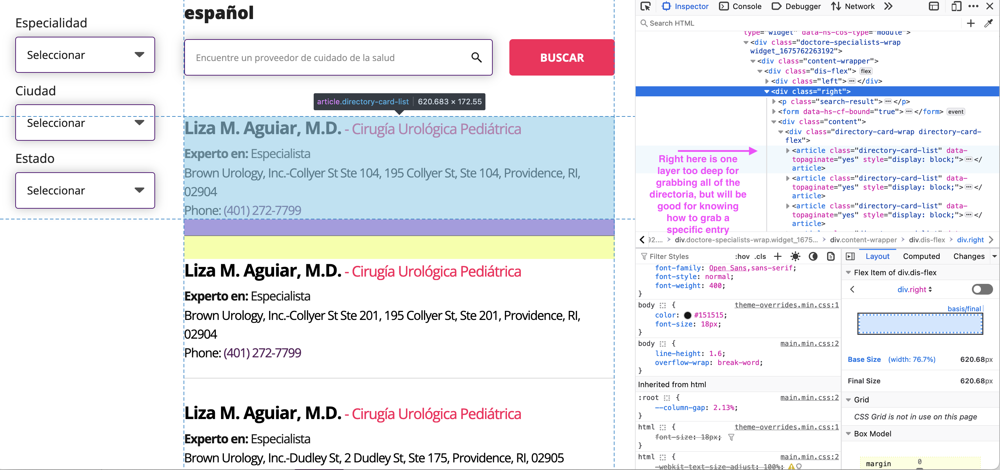


In [4]:
results=soup.find(class_="directory-card-wrap directory-card-flex")
directoria_medico=results.find_all("article")
directoria=[]
for medico in directoria_medico:
    medico_y_experto=medico.find("h5").text
    ubicacion=medico.find("p").text.strip()
    experto_en=medico.find(class_="exper-content").text.strip()
    telefono=medico.find("a").text
    #print(experto_en)
    #break
    directoria.append([medico_y_experto, experto_en, ubicacion, telefono])

The code cell below checks that our list is long enough and grabbed everything in the directoria. Since the webpage had 995 results today, then this command should also output 995. 

In [5]:
len(directoria)

995

Now we use the python package of pandas to make a data frame out of the list.

In [6]:
#directoria_data=pd.DataFrame(directoria, columns=["Nombre","Ubicación"])
directoria_data=pd.DataFrame(directoria, columns=["Nombre y Experto","Experto en","Ubicación","Teléfono"])
directoria_data

,Nombre y Experto,Experto en,Ubicación,Teléfono
0,"Liza M. Aguiar, M.D. - Cirugía Urológica Pediá...",Experto en: Especialista,"Brown Urology, Inc.-Collyer St Ste 104,\n ...",(401) 272-7799
1,"Liza M. Aguiar, M.D. - Cirugía Urológica Pediá...",Experto en: Especialista,"Brown Urology, Inc.-Collyer St Ste 201,\n ...",(401) 272-7799
2,"Liza M. Aguiar, M.D. - Cirugía Urológica Pediá...",Experto en: Especialista,"Brown Urology, Inc.-Dudley St,\n ...",(401) 421-0710
3,"Liza M. Aguiar, M.D. - Cirugía Urológica Pediá...",Experto en: Especialista,"Brown Urology, Inc.-E. Prov,\n ...",(401) 435-6600
4,"Liza M. Aguiar, M.D. - Cirugía Urológica Pediá...",Experto en: Especialista,"Brown Urology, Inc.-N. Main St,\n ...",(401) 276-2060
...,...,...,...,...
990,"Paul F. Zino, M.D. - Radiología Diagnóstica",Experto en: Especialista,"Southern New England Radiology - Purchase St,\...",(508) 992-6553
991,"Paul F. Zino, M.D. - Radiología Diagnóstica",Experto en: Especialista,Southern New England Radiology - Rosebrook Way...,(508) 961-5856
992,"Paul F. Zino, M.D. - Radiología Diagnóstica",Experto en: Especialista,"Southern New England Radiology - Swansea,\n ...",(508) 672-5300
993,"Paul F. Zino, M.D. - Radiología Diagnóstica",Experto en: Especialista,"Southern New England Radiology - Westport,\n ...",(508) 973-1540


## Cleaning the Data from Nuestra Salud

In the next code cell we are using regular expressions to clean the data. Notice above in `Nombre y Experto` has a lot of information in it and `Ubicación` is also more than just an address. Regular expressions give us the means to take apart the different parts and split them into their own columns. This is hard and takes a lot of trial and error. For a tutorial that teaches you what a regular expression is go here: https://regexone.com/. You can use this site for testing different regular expression: https://regexr.com/. Copy paste a few of the data entries into `Text` on the website and then test different regular expressions learned on regexone. 

Some places that could break is that the doctors and nurses have different length names, some people have different types of degrees and different amounts. The locations could also change.

* `Nombre`--The Doctor, nurse, or translators name
* `Grado` --The Doctor, nurse, or translators degree
* `Grado Dos` --The Doctor, nurse, or translators second degree if they have one
* `Especialidad` --The Doctor, nurse, or translators specialization in their field.
* `Hospital` -- Where the Doctor, nurse, or translators works
* `Dirección` --The address of the health center
* `Número de` --The second line of the address, if it exists.
* `Ciudad` --The city that this health center is located
* `Estado` --The state that this health center is location, either RI, MA, or CT.
* `Código Postal` --The zip code of this health center
* `Experto en` --A broad specialization category named by Nuestra Salud
* `Teléfono` --The health centers phone number

In [8]:
nombre_y_experto=directoria_data["Nombre y Experto"].str.extract("(\w*\.*\s*\w+\s*\w*\.*\s*D*e*\s*\w+-*\w+\s*D*e*\s*\w*\s*\w*),*\s*(\w\.\w\.-*\w*\.*)*,*\s*(\w\.\w\.\w.\w*\.*)*\s*-*\s*(\w+\s*\w+\s*\w+\s*\w+\s*\w+\s*\w+)")

ubi=directoria_data["Ubicación"].str.extract("(.+[^-]),\s*([^,]+),\s*([^,]+[,$])*([^,]+[,$])([^,]+[,$])") #([^,]+[,$])([^,]+[,$])
ubi[2]=ubi[2].str.replace(",","")
ubi[3]=ubi[3].str.replace("\s*(.+),",r"\1",regex=True)
ubi[3]

estado_y_código_postal =directoria_data["Ubicación"].str.extract("(.*?)\s*(\d+(?:[/-]\d+)?)?$")
estado_y_código_postal[0]=estado_y_código_postal[0].str.replace(",","",)
directoria_data["Estado"]=estado_y_código_postal[0]
directoria_data["Código Postal"]=estado_y_código_postal[1].astype("str")

directoria_data["Nombre"]=nombre_y_experto[0]
directoria_data["Grado"]=nombre_y_experto[1]
directoria_data["Grado Dos"]=nombre_y_experto[2]
directoria_data["Especialidad"]=nombre_y_experto[3]

directoria_data["Hospital"]=ubi[0]
directoria_data["Dirección"]=ubi[1]
directoria_data["Número de"]=ubi[2]
directoria_data["Ciudad"]=ubi[3]


directoria_data=directoria_data.reindex(columns=["Nombre", "Grado","Grado Dos","Especialidad", "Hospital", "Dirección", "Número de", "Ciudad","Estado", "Código Postal", "Experto en","Teléfono"])
directoria_data.to_csv('Nuestra_Salud_directoria.csv', index=False)

directoria_data


,Nombre,Grado,Grado Dos,Especialidad,Hospital,Dirección,Número de,Ciudad,Estado,Código Postal,Experto en,Teléfono
0,Liza M. Aguiar,M.D.,NaN,Cirugía Urológica Pediátrica,"Brown Urology, Inc.-Collyer St Ste 104",195 Collyer St,Ste 104,Providence,RI,02904,Experto en: Especialista,(401) 272-7799
1,Liza M. Aguiar,M.D.,NaN,Cirugía Urológica Pediátrica,"Brown Urology, Inc.-Collyer St Ste 201",195 Collyer St,Ste 201,Providence,RI,02904,Experto en: Especialista,(401) 272-7799
2,Liza M. Aguiar,M.D.,NaN,Cirugía Urológica Pediátrica,"Brown Urology, Inc.-Dudley St",2 Dudley St,Ste 175,Providence,RI,02905,Experto en: Especialista,(401) 421-0710
3,Liza M. Aguiar,M.D.,NaN,Cirugía Urológica Pediátrica,"Brown Urology, Inc.-E. Prov",450 Veterans Memorial Pkwy,Bldg 14,East Providence,RI,02914,Experto en: Especialista,(401) 435-6600
4,Liza M. Aguiar,M.D.,NaN,Cirugía Urológica Pediátrica,"Brown Urology, Inc.-N. Main St",827 N Main St,Ste 4,Providence,RI,02904,Experto en: Especialista,(401) 276-2060
...,...,...,...,...,...,...,...,...,...,...,...,...
990,Paul F. Zino,M.D.,NaN,Radiología Diagnóstica,Southern New England Radiology - Purchase St,874 Purchase St,NaN,New Bedford,MA,02740,Experto en: Especialista,(508) 992-6553
991,Paul F. Zino,M.D.,NaN,Radiología Diagnóstica,Southern New England Radiology - Rosebrook Way,100 Rosebrook Way,Ste 101,Wareham,MA,02571,Experto en: Especialista,(508) 961-5856
992,Paul F. Zino,M.D.,NaN,Radiología Diagnóstica,Southern New England Radiology - Swansea,479 Swansea Mall Dr,NaN,Swansea,MA,02777,Experto en: Especialista,(508) 672-5300
993,Paul F. Zino,M.D.,NaN,Radiología Diagnóstica,Southern New England Radiology - Westport,827 American Legion Hwy,Ste 1,Westport,MA,02790,Experto en: Especialista,(508) 973-1540


This code cell below tells us currently how many Spanish speaking doctors, nurses, or translators in the RI area (with a few entries that include MA and CT).

In [10]:
len(directoria_data["Nombre"].unique())

339

## Manipulating the data
Here with use Pandas manipulation to see which health centers have which specializations. This is then saves in `tipo_data`.

In [12]:
tipo_data=directoria_data.groupby(["Hospital","Especialidad"])["Nombre"].count().unstack().fillna(0)

tipo_data.to_csv('tipo_data.csv', index=True)
tipo_data

Especialidad,Acupunturista,Alergia e Inmunología,Anestesiología,Audiología,Cirugía General,Cirugía Neurológica,Cirugía Ortopédica,Cirugía Ortopédica de la Columna Vertebral,Cirugía Ortopédica de la Mano,Cirugía Torácica,...,Podología,Quiropráctico,Radiología Diagnóstica,Radiología Diagnóstica por Ultrasonido,Radiología Oncología Radioterápica,Reumatología,Terapia Física,Terapia del Habla,Trabajador de Salud Comunitario,Urología
Hospital,,,,,,,,,,,,,,,,,,,,,
20/20 Vision Care Inc,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
"A Pediatric Evolution, LLC",1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AFF-CNEMG Pulmonary Services,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AFF-Integra Complex Care,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
AFF-WIH Dept of Anesthesiology,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"Wellness Connect Go Beyond Medicine, LLC",0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Wellness Connect Go Beyond Medicine-Suite 201,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Westminster Eyecare Associates,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Below here is just playing with the data set and comparing it to census 2020 data

Some major flaws of the census data is that not all the towns were available and it only has people who identify as hispanic in these cites, but it doesn't know who is a native Spanish speaker (or other languages). So if we can get a better sources of this information, just upload it in place of `CT_MA_RI_2020_Hispanic_census_data.csv` and make sure to rename City to Ciudad so that pandas will merge on the cities. 

We can use the Nuestra Salud data with the census data to get a measure of how many health practitioners who speak spanish and compare it to those that identify as Hispanic in RI and a few towns in MA and CT. The data cells below grab this census data, rename the files, clean the Nuestra Salud without duplicates (some health practitioners work at many health centers), and then merges the data frames into one CSV file. 

We then use the two different counts to create a proportion of people who identify as hispanic in 2020 census in town A/number of health practitioners who speak Spanish in town A.

In [15]:
census_data = pd.read_csv('CT_MA_RI_2020_Hispanic_census_data.csv')
#census_data["2020"]=census_data["2020"].str.replace(",","").astype("int32")


In [16]:
#ciudad_data
#directoria_data.groupby(["Ciudad","Nombre"]).count().unstack().fillna(0)
directoria_dupes=directoria_data.drop_duplicates(["Nombre","Ciudad"])
df=directoria_dupes.groupby("Ciudad")["Nombre"].count()
city_count_data=pd.DataFrame(df)
city_count_data=city_count_data.reset_index()
city_count_data = city_count_data.rename(columns={'Nombre': 'Numero'})
city_count_data
city_and_census=pd.merge(city_count_data, census_data)
#
city_and_census

,Ciudad,Numero,Estado,2020
0,Barrington,6,RI,623
1,Bristol,11,RI,959
2,Central Falls,10,RI,14752
3,Coventry,9,RI,1229
4,Cranston,24,RI,15067
5,Cumberland,5,RI,2692
6,Dartmouth,1,MA,1360
7,East Greenwich,28,RI,595
8,East Providence,29,RI,3328
9,Fairhaven,3,MA,501


In [17]:
city_and_census["Proporción"]=city_and_census["2020"]/city_and_census["Numero"]
city_and_census["Proporción"]=city_and_census["Proporción"].astype("int32")
city_and_census.to_csv('Count_by_city_data.csv', index=True)

In [166]:
city_and_census

,Ciudad,Numero,Estado,2020,Proporción
0,Barrington,6,RI,623,103
1,Bristol,11,RI,959,87
2,Central Falls,10,RI,14752,1475
3,Coventry,9,RI,1229,136
4,Cranston,24,RI,15067,627
5,Cumberland,5,RI,2692,538
6,Dartmouth,1,MA,1360,1360
7,East Greenwich,28,RI,595,21
8,East Providence,29,RI,3328,114
9,Fairhaven,3,MA,501,167


## Making pretty pictures

There are likely better ways to make maps with this data, but this is the best I can do at the moment. I grabbed FIPS data from the internet about RI, MA, and CT and merged this with our `Count_by_city_data.csv`. A FIPS code is something that geopandas needs in order to plot the data on a map of RI, MA and CT. 

In [19]:
FIPS_data = pd.read_csv('FIPS.csv', dtype={"StCnty FIPS Code" : str})

FIPS_data = FIPS_data.rename(columns={'City Name': 'Ciudad', 'State Code':'Estado',"StCnty FIPS Code":"fips"})
FIPS_data["Ciudad"]=FIPS_data["Ciudad"].str.lower().str.capitalize()
#geo_data2.to_csv('Combined_Health_FIPS_data.csv', index=False)
FIPS_data

,State Name,County Name,Ciudad,Estado,State FIPS Code,County Code,fips,City Code,StCntyCity FIPS Code
0,ALABAMA,AUTAUGA,Autaugaville,AL,1,C001,01001,220.0,10010220.0
1,ALABAMA,AUTAUGA,Billingsley,AL,1,C001,01001,340.0,10010340.0
2,ALABAMA,AUTAUGA,Booth,AL,1,C001,01001,425.0,10010425.0
3,ALABAMA,AUTAUGA,Jones,AL,1,C001,01001,1796.0,10011796.0
4,ALABAMA,AUTAUGA,Marbury,AL,1,C001,01001,2002.0,10012002.0
...,...,...,...,...,...,...,...,...,...
39784,WYOMING,WASHAKIE,Ten sleep,WY,56,C043,56043,810.0,560430810.0
39785,WYOMING,WASHAKIE,Worland,WY,56,C043,56043,890.0,560430890.0
39786,WYOMING,WESTON,Newcastle,WY,56,C045,56045,610.0,560450610.0
39787,WYOMING,WESTON,Osage,WY,56,C045,56045,623.0,560450623.0


In [20]:
geo_data2=pd.merge(city_and_census,FIPS_data)
geo_data2.to_csv('Combined_Health_FIPS_data.csv', index=False)


In [21]:
geo=pd.read_csv("Combined_Health_FIPS_data.csv",dtype={"fips": str, "Proporción": int, "2020":int})
geo

,Ciudad,Numero,Estado,2020,Proporción,State Name,County Name,State FIPS Code,County Code,fips,City Code,StCntyCity FIPS Code
0,Barrington,6,RI,623,103,RHODE ISLAND,BRISTOL,44,C001,44001,13.0,440010013.0
1,Bristol,11,RI,959,87,RHODE ISLAND,BRISTOL,44,C001,44001,30.0,440010030.0
2,Coventry,9,RI,1229,136,RHODE ISLAND,KENT,44,C003,44003,48.0,440030048.0
3,Cranston,24,RI,15067,627,RHODE ISLAND,PROVIDENCE,44,C007,44007,50.0,440070050.0
4,Cumberland,5,RI,2692,538,RHODE ISLAND,PROVIDENCE,44,C007,44007,47.0,440070047.0
5,Dartmouth,1,MA,1360,1360,MASSACHUSETTS,BRISTOL,25,C005,25005,251.0,250050251.0
6,Fairhaven,3,MA,501,167,MASSACHUSETTS,BRISTOL,25,C005,25005,315.0,250050315.0
7,Foster,1,RI,91,91,RHODE ISLAND,PROVIDENCE,44,C007,44007,59.0,440070059.0
8,Greenville,4,RI,342,85,RHODE ISLAND,PROVIDENCE,44,C007,44007,65.0,440070065.0
9,Groton,2,CT,1243,621,CONNECTICUT,NEW LONDON,9,C011,09011,260.0,90110260.0


In [22]:
geo.Proporción.max()
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})
df.head()

,fips,unemp
0,01001,5.3
1,01003,5.4
2,01005,8.6
3,01007,6.6
4,01009,5.5


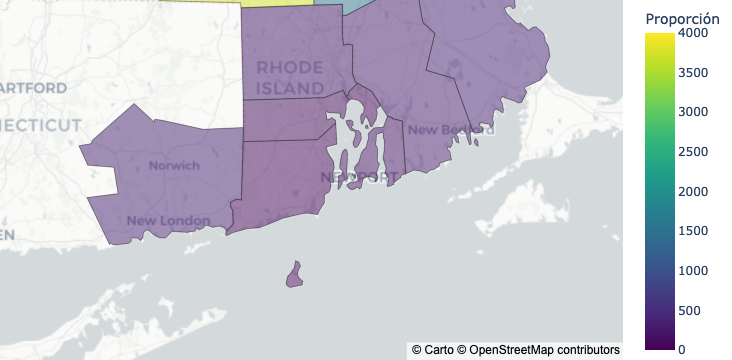

In [23]:
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)
fig = px.choropleth_mapbox(geo, geojson=counties, locations='fips', color='Proporción',
                           color_continuous_scale="Viridis",
                           range_color=(0, 4000),
                           mapbox_style="carto-positron",
                           zoom=7.5, center = {"lat": 41.5, "lon": -71.5},
                           opacity=0.5,
                           labels={'Ciudad':'Proporción'}
                          )

fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()


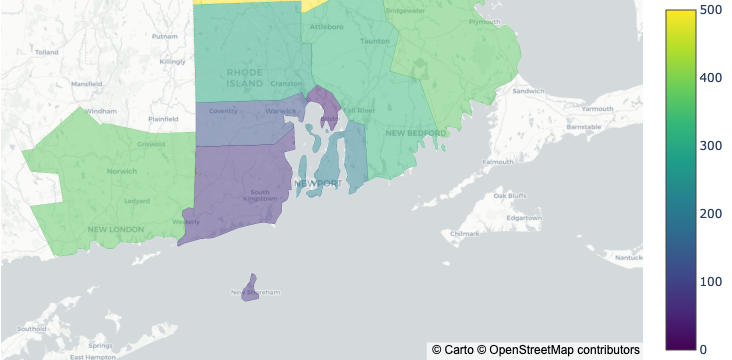

In [27]:
fig = go.Figure(go.Choroplethmapbox(geojson=counties, locations=geo.fips, z=geo.Proporción,
                                    colorscale="Viridis", zmin=0, zmax=500,
                                    marker_opacity=0.5, marker_line_width=0))
fig.update_layout(mapbox_style="carto-positron",
                  mapbox_zoom=7.5, mapbox_center = {"lat": 41.5, "lon": -71.3})
fig.update_layout(margin={"r":0,"t":0,"l":0.5,"b":0})
fig.show()

We can make scatterplots of these data sets as well now that we've manipulated the data sets, merged them, and made new columns with new computations.

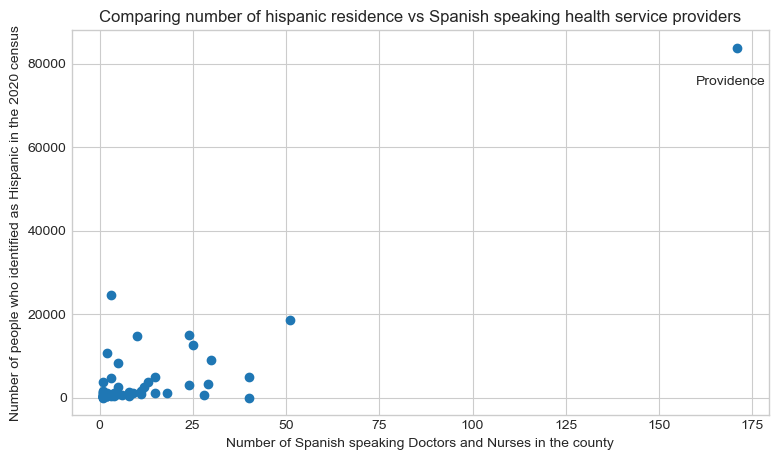

In [140]:
 ###Let's make an image
fig = plt.figure(figsize=(9,5)) # figure size (width, height)
x = geo["2020"]
y= geo["Numero"]
#fig, ax = plt.subplots()
plt.title("Comparing number of hispanic residence vs Spanish speaking health service providers")
plt.xlabel('Number of Spanish speaking Doctors and Nurses in the county')
plt.ylabel('Number of people who identified as Hispanic in the 2020 census')
plt.text(160,75000, "Providence")
plt.scatter(y,x)